# 10. 프로젝트 : CIFAR-10 이미지 생성하기


## 목차

> <p style="font-size:17px">STEP 1. 작업환경 구성하기</p>
  <p style="font-size:17px">STEP 2. 데이터셋 구성하기</p> 
  <p style="font-size:17px">STEP 3. 생성자 모델 구현하기</p>
  <p style="font-size:17px">STEP 4. 판별자 모델 구현하기</p>
  <p style="font-size:17px">STEP 5. 손실함수와 최적화 함수 구현하기</p>
  <p style="font-size:17px">STEP 6. 훈련과정 상세 기능 구현하기</p>
  <p style="font-size:17px">STEP 7. 학습 과정 진행하기</p>
  <p style="font-size:17px">STEP 8. (optional) GAN 훈련 과정 개선하기</p>


## 루브릭 (프로젝트 평가 기준)

> |<p style="font-size:15px"> 평가문항 </p>                                |<p style="font-size:15px"> 상세기준 </p>        |
  |------------------------------------------------------------------------|------------------------------------------------|
  |1. GAN의 두 모델 구조를 통해 이미지를 성공적으로 생성하였다. |오브젝트 종류를 육안으로 구별할 수 있을 만한 이미지를 생성하였다.|
  | 2. 생성 이미지 시각화 및 학습 그래프를 통해 GAN 학습이 바르게 진행되었음을 입증하였다.| gif를 통해 생성이미지 품질이 서서히 향상되는 것과, fake accuracy가 추세적으로 0.5를 향해 하향하고 있음을 확인하였다.|
  | 3. 추가적인 GAN 모델구조 혹은 학습과정 개선 아이디어를 제안하고 이를 적용하였다. |제출 아이디어를 제출 프로젝트에 반영하고, 그 결과가 아이디어 적용 이전보다 향상되었음을 시각적으로 입증하였다.|

## STEP 1. 작업환경 구성하기


In [1]:
import os
import glob
import time

import PIL
import imageio
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers
from IPython import display
import matplotlib.pyplot as plt
%matplotlib inline

print("tensorflow", tf.__version__)

tensorflow 2.6.0


## STEP 2. 데이터셋 구성하기


* CIFAR-10 이미지를 불러옵니다.

In [2]:
cifar10 = tf.keras.datasets.cifar10

(train_x, _), (test_x, _) = cifar10.load_data()

train_x.shape

(50000, 32, 32, 3)

* 0에서 255사이의 정숫값을 가지고 있는 것을 확인할 수 있습니다. 

In [3]:
print("max pixel:", train_x.max())
print("min pixel:", train_x.min())

max pixel: 255
min pixel: 0


* 각 픽셀을 -1에서 1로 정규화 시킵니다. 
    * 127.5를 빼서 중간 값을 0으로 맞춘 후에 127.5로 나누어줍니다. 

In [4]:
train_x = (train_x - 127.5) / 127.5 # 이미지를 [-1, 1]로 정규화합니다.

print("max pixel:", train_x.max())
print("min pixel:", train_x.min())

max pixel: 1.0
min pixel: -1.0


* 50,000개의 CIFAR-10 데이터가 32x32 사이즈로 이루어져 있으며, (R, G, B) 3개의 채널을 갖고 있습니다.

In [5]:
train_x.shape

(50000, 32, 32, 3)

* 우선 하나의 데이터를 확인 해보겠습니다.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


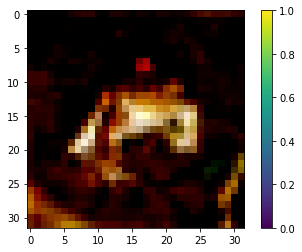

In [6]:
plt.imshow(train_x[0].reshape(32, 32, 3))
plt.colorbar()
plt.show()

* 10가지의 데이터 종류가 있으니 각각의 종류에서 데이터를 하나씩 확인해보겠습니다.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

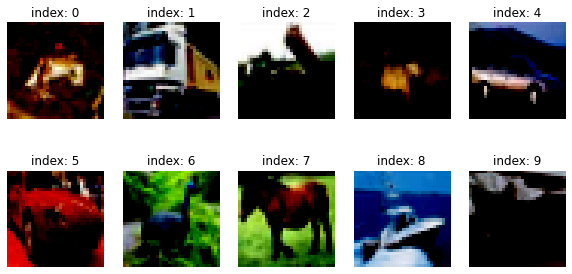

In [7]:
plt.figure(figsize=(10, 5))

for i in range(10):
    plt.subplot(2, 5, i+1)
    plt.imshow(train_x[i].reshape(32, 32, 3))
    plt.title(f'index: {i}')
    plt.axis('off')
plt.show()

* CIFAR-10 데이터 셋 중에서 랜덤하게 25개를 골라서 확인해보겠습니다.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

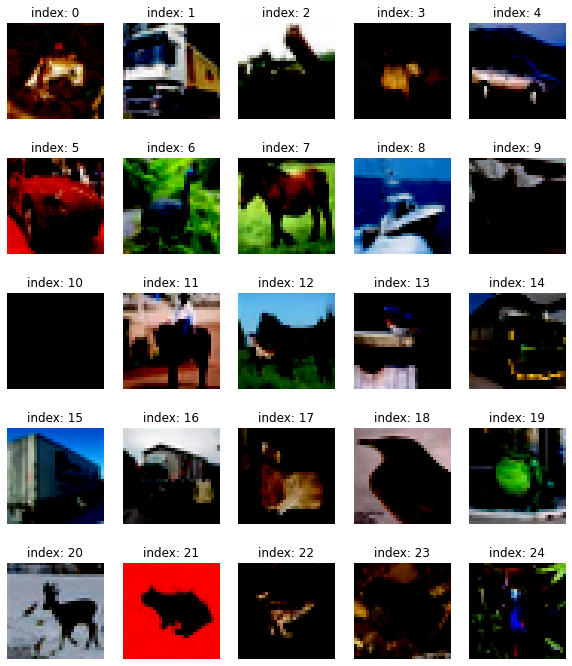

In [8]:
plt.figure(figsize=(10, 12))

for i in range(25):
    plt.subplot(5,5,i+1)
    random_index = np.random.randint(1, 50000)
    plt.imshow(train_x[i].reshape(32, 32, 3))
    plt.title(f'index: {i}')
    plt.axis('off')

plt.show()

* 버퍼사이즈를 50,000을 지정해서 전체 데이터를 잘 섞어서 모델에 넣어줄 수 있도록 합니다. 
* 배치사이즈는 256으로 지정하여 효율적인 학습이 가능하도록 합니다. 

In [9]:
BUFFER_SIZE = 50000
# BATCH_SIZE = 256
BATCH_SIZE = 128

* 지정한 버퍼사이즈와 배치사이즈를 사용하여 미니배치 학습 시스템을 만들어줍니다. 

In [10]:
train_dataset = tf.data.Dataset.from_tensor_slices(train_x).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

## STEP 3. 생성자 모델 구현하기


In [11]:
## ORIGINAL
# def make_generator_model():

#     # Start
#     model = tf.keras.Sequential()

#     # First: Dense layer
#     model.add(layers.Dense(4*4*256, use_bias=False, input_shape=(100,)))
#     model.add(layers.BatchNormalization())
#     model.add(layers.LeakyReLU())

#     # Second: Reshape layer
#     model.add(layers.Reshape((4, 4, 256)))

#     # Third: Conv2DTranspose layer
#     model.add(layers.Conv2DTranspose(128, kernel_size=(4, 4), strides=(2, 2), padding='same', use_bias=False))
#     model.add(layers.BatchNormalization())
#     model.add(layers.LeakyReLU())

#     # Fourth: Conv2DTranspose layer
#     model.add(layers.Conv2DTranspose(128, kernel_size=(4, 4), strides=(2, 2), padding='same', use_bias=False))
#     model.add(layers.BatchNormalization())
#     model.add(layers.LeakyReLU())

#     # Fifth: Conv2DTranspose layer
#     model.add(layers.Conv2DTranspose(3, kernel_size=(3, 3), strides=(2, 2), padding='same', use_bias=False, \
#                                      activation='tanh'))

#     return model

In [12]:
# ## 1st_MODIFIED

# def make_generator_model():

#     # Start
#     model = tf.keras.Sequential()

#     # First: Dense layer
#     model.add(layers.Dense(4*4*256, use_bias=False, input_shape=(100,)))
#     #model.add(layers.BatchNormalization())
#     model.add(layers.LeakyReLU(alpha=0.2))

#     # Second: Reshape layer
#     model.add(layers.Reshape((4, 4, 256)))

#     # Third: Conv2DTranspose layer
#     model.add(layers.Conv2DTranspose(128, kernel_size=(4, 4), strides=(2, 2), padding='same', use_bias=False))
#     #model.add(layers.BatchNormalization())
#     model.add(layers.LeakyReLU(alpha=0.2))

#     # Fourth: Conv2DTranspose layer
#     model.add(layers.Conv2DTranspose(128, kernel_size=(4, 4), strides=(2, 2), padding='same', use_bias=False))
#     #model.add(layers.BatchNormalization())
#     model.add(layers.LeakyReLU(alpha=0.2))
    
#     # Fifth: Conv2DTranspose layer
#     model.add(layers.Conv2DTranspose(128, kernel_size=(4, 4), strides=(2, 2), padding='same', use_bias=False))
#     #model.add(layers.BatchNormalization())
#     model.add(layers.LeakyReLU(alpha=0.2))
    
#     # Sixth: Conv2DTranspose layer
#     model.add(layers.Conv2D(3, kernel_size=(3, 3), padding='same', use_bias=False, \
#                                      activation='tanh'))

#     return model

In [13]:
# ## 2nd_MODIFIED

# def make_generator_model():

#     # Start
#     model = tf.keras.Sequential()

#     # First: Dense layer
#     model.add(layers.Dense(4*4*512, use_bias=False, input_shape=(100,)))
#     model.add(layers.BatchNormalization())
#     model.add(layers.ReLU())

#     # Second: Reshape layer
#     model.add(layers.Reshape((4, 4, 512)))

#     # Third: Conv2DTranspose layer
#     model.add(layers.Conv2DTranspose(256, kernel_size=(4, 4), strides=(2, 2), padding='same', use_bias=False))
#     model.add(layers.BatchNormalization())
#     model.add(layers.ReLU())

#     # Fourth: Conv2DTranspose layer
#     model.add(layers.Conv2DTranspose(128, kernel_size=(4, 4), strides=(2, 2), padding='same', use_bias=False))
#     model.add(layers.BatchNormalization())
#     model.add(layers.ReLU())
    
#     # Fifth: Conv2DTranspose layer
#     model.add(layers.Conv2DTranspose(3, kernel_size=(4, 4), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))

#     return model

In [14]:
# ## 3rd_MODIFIED

# def make_generator_model():

#     # Start
#     model = tf.keras.Sequential()

#     # First: Dense layer
#     model.add(layers.Dense(4*4*256, use_bias=False, input_shape=(100,)))
#     model.add(layers.LeakyReLU(alpha=0.2))
    
#     # Second: Reshape layer
#     model.add(layers.Reshape((4, 4, 256)))

#     # Third: Conv2DTranspose layer
#     model.add(layers.Conv2DTranspose(128, kernel_size=(4, 4), strides=(2, 2), padding='same', use_bias=False))
#     model.add(layers.LeakyReLU(alpha=0.2))

#     # Fourth: Conv2DTranspose layer
#     model.add(layers.Conv2DTranspose(128, kernel_size=(4, 4), strides=(2, 2), padding='same', use_bias=False))
#     model.add(layers.LeakyReLU(alpha=0.2))
    
#     # Fifth: Conv2DTranspose layer
#     model.add(layers.Conv2DTranspose(128, kernel_size=(4, 4), strides=(2, 2), padding='same', use_bias=False))
#     model.add(layers.LeakyReLU(alpha=0.2))
    
#     # Sixth: Conv2DTranspose layer
#     model.add(layers.Conv2DTranspose(3, kernel_size=(3, 3), padding='same', use_bias=False, activation='tanh'))

#     return model

In [15]:
## 4th_MODIFIED

def make_generator_model():

    # Start
    model = tf.keras.Sequential()

    # First: Dense layer
    model.add(layers.Dense(4*4*256, use_bias=False, input_shape=(100,)))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    
    # Second: Reshape layer
    model.add(layers.Reshape((4, 4, 256)))

    # Third: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(128, kernel_size=(4, 4), strides=(2, 2), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())

    # Fourth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(128, kernel_size=(4, 4), strides=(2, 2), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    
    # Fifth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(128, kernel_size=(4, 4), strides=(2, 2), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    
    # Sixth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(3, kernel_size=(3, 3), padding='same', use_bias=False, activation='tanh'))

    return model

In [16]:
generator = make_generator_model()

generator.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 4096)              409600    
_________________________________________________________________
batch_normalization (BatchNo (None, 4096)              16384     
_________________________________________________________________
re_lu (ReLU)                 (None, 4096)              0         
_________________________________________________________________
reshape (Reshape)            (None, 4, 4, 256)         0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 8, 8, 128)         524288    
_________________________________________________________________
batch_normalization_1 (Batch (None, 8, 8, 128)         512       
_________________________________________________________________
re_lu_1 (ReLU)               (None, 8, 8, 128)         0

* shape=(1, 100)의 형상을 가지는 랜덤 노이즈 벡터를 생성해서 결과물을 한번 만들어보겠습니다. 

In [17]:
noise = tf.random.normal([1, 100])

* [1, 32, 32, 3] 의 사이즈를 가진 이미지가 생성됐습니다.

In [18]:
generated_image = generator(noise, training=False)
generated_image.shape

TensorShape([1, 32, 32, 3])

## STEP 4. 판별자 모델 구현하기


In [19]:
## ORIGINAL

# def make_discriminator_model():

#     # Start
#     model = tf.keras.Sequential()

#     # First: Conv2D Layer
#     model.add(layers.Conv2D(128, (3, 3), strides=(3, 3), padding='same', input_shape=[32, 32, 3]))
#     model.add(layers.LeakyReLU())
#     model.add(layers.Dropout(0.3))

#     # Second: Conv2D Layer
#     model.add(layers.Conv2D(256, (3, 3), strides=(3, 3), padding='same'))
#     model.add(layers.LeakyReLU())
#     model.add(layers.Dropout(0.3))

#     # Third: Flatten Layer
#     model.add(layers.Flatten())

#     # Fourth: Dense Layer
#     model.add(layers.Dense(1))

#     return model

In [20]:
# ## 1st_MODIFIED

# def make_discriminator_model():

#     # Start
#     model = tf.keras.Sequential()

#     # First: Conv2D Layer
#     model.add(layers.Conv2D(64, (3, 3), padding='same', input_shape=[32, 32, 3]))
#     model.add(layers.LeakyReLU(alpha=0.2))
#     #model.add(layers.Dropout(0.3))

#     # Second: Conv2D Layer
#     model.add(layers.Conv2D(128, (3, 3), strides=(2, 2), padding='same'))
#     model.add(layers.LeakyReLU(alpha=0.2))
#     #model.add(layers.Dropout(0.3))

#     # Third: Conv2D Layer
#     model.add(layers.Conv2D(128, (3, 3), strides=(2, 2), padding='same'))
#     model.add(layers.LeakyReLU(alpha=0.2))
#     #model.add(layers.Dropout(0.3))
    
#     # Fourth: Conv2D Layer
#     model.add(layers.Conv2D(256, (3, 3), strides=(2, 2), padding='same'))
#     model.add(layers.LeakyReLU(alpha=0.2))
#     #model.add(layers.Dropout(0.3))
    
#     # Fifth: Flatten Layer
#     model.add(layers.Flatten())
#     model.add(layers.Dropout(0.4))
        
#     # Sixth: Dense Layer
#     model.add(layers.Dense(1, activation='sigmoid'))

#     return model

In [21]:
# ## 2nd_MODIFIED

# def make_discriminator_model():

#     # Start
#     model = tf.keras.Sequential()

#     # First: Conv2D Layer
#     model.add(layers.Conv2D(96, (3, 3), padding='same', input_shape=[32, 32, 3]))
#     model.add(layers.LeakyReLU(0.2))
#     model.add(layers.Conv2D(96, (3, 3), padding='same'))
#     model.add(layers.LeakyReLU(0.2))

#     # Second: Conv2D Layer
#     model.add(layers.Conv2D(96, (3, 3), strides=(2, 2), padding='same'))
#     model.add(layers.LeakyReLU(0.2))
#     model.add(layers.Dropout(0.5))

#     # Third: Conv2D Layer
#     model.add(layers.Conv2D(192, (3, 3), padding='same'))
#     model.add(layers.LeakyReLU(0.2))
        
#     # Fourth: Conv2D Layer
#     model.add(layers.Conv2D(192, (3, 3), padding='same'))
#     model.add(layers.LeakyReLU(0.2))
        
        
#     model.add(layers.Conv2D(192, (3, 3), strides=(2, 2), padding='same'))
#     model.add(layers.LeakyReLU(0.2))    
#     model.add(layers.Dropout(0.5))
    
    
#     model.add(layers.Conv2D(192, (3, 3), strides=(1, 1), padding='valid'))
#     model.add(layers.LeakyReLU(0.2))
    
#     model.add(layers.Conv2D(192, (1, 1), strides=(1, 1), padding='valid'))
#     model.add(layers.LeakyReLU(0.2))
    
#     model.add(layers.Conv2D(192, (1, 1), strides=(1, 1), padding='valid'))
#     model.add(layers.LeakyReLU(0.2))
            
#     # Fifth: Flatten Layer
#     model.add(layers.Flatten())
        
#     # Sixth: Dense Layer
#     model.add(layers.Dense(1, activation='sigmoid'))

#     return model

In [22]:
# ## 3rd_MODIFIED

# def make_discriminator_model():

#     # Start
#     model = tf.keras.Sequential()

#     # First: Conv2D Layer
#     model.add(layers.Conv2D(64, (3, 3), padding='same', input_shape=[32, 32, 3]))
#     model.add(layers.LeakyReLU(alpha=0.2))
#     model.add(layers.Conv2D(128, (3, 3), strides=(2,2), padding='same'))
#     model.add(layers.LeakyReLU(alpha=0.2))

#     # Second: Conv2D Layer
#     model.add(layers.Conv2D(128, (3, 3), strides=(2, 2), padding='same'))
#     model.add(layers.LeakyReLU(0.2))
    
#     # Third: Conv2D Layer
#     model.add(layers.Conv2D(256, (3, 3), strides=(2,2), padding='same'))
#     model.add(layers.LeakyReLU(alpha=0.2))
                    
#     # Fifth: Flatten Layer
#     model.add(layers.Flatten())
#     model.add(layers.Dropout(0.4))

#     # Sixth: Dense Layer
#     model.add(layers.Dense(1, activation='sigmoid'))

#     return model

In [23]:
## 4th_MODIFIED

def make_discriminator_model():

    # Start
    model = tf.keras.Sequential()

    # First: Conv2D Layer
    model.add(layers.Conv2D(64, (3, 3), padding='same', input_shape=[32, 32, 3]))
    model.add(layers.LeakyReLU(alpha=0.2))
    model.add(layers.Conv2D(128, (3, 3), strides=(2,2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=0.2))

    # Second: Conv2D Layer
    model.add(layers.Conv2D(128, (3, 3), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(0.2))
    
    # Third: Conv2D Layer
    model.add(layers.Conv2D(256, (3, 3), strides=(2,2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=0.2))
                    
    # Fifth: Flatten Layer
    model.add(layers.Flatten())
    model.add(layers.Dropout(0.4))

    # Sixth: Dense Layer
    model.add(layers.Dense(1, activation='sigmoid'))

    return model

In [24]:
discriminator = make_discriminator_model()

discriminator.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 32, 32, 64)        1792      
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 32, 32, 64)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 16, 16, 128)       73856     
_________________________________________________________________
batch_normalization_4 (Batch (None, 16, 16, 128)       512       
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 16, 16, 128)       0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 8, 8, 128)         147584    
_________________________________________________________________
batch_normalization_5 (Batch (None, 8, 8, 128)        

## STEP 5. 손실함수와 최적화 함수 구현하기


In [25]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [26]:
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

In [27]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

In [28]:
def discriminator_accuracy(real_output, fake_output):
    real_accuracy = tf.reduce_mean(tf.cast(tf.math.greater_equal(real_output, tf.constant([0.5])), tf.float32))
    fake_accuracy = tf.reduce_mean(tf.cast(tf.math.less(fake_output, tf.constant([0.5])), tf.float32))
    return real_accuracy, fake_accuracy

In [29]:
# generator_optimizer = tf.keras.optimizers.Adam(1e-4)
# discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

In [30]:
#3rd modified
generator_optimizer = tf.keras.optimizers.Adam(2e-4, 0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, 0.5)

In [31]:
noise_dim = 100
num_examples_to_generate = 16

seed = tf.random.normal([num_examples_to_generate, noise_dim])
seed.shape

TensorShape([16, 100])

## STEP 6. 훈련과정 상세 기능 구현하기


In [32]:
@tf.function
def train_step(images):  #(1) 입력데이터
    noise = tf.random.normal([BATCH_SIZE, noise_dim])  #(2) 생성자 입력 노이즈

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:  #(3) tf.GradientTape() 오픈
        generated_images = generator(noise, training=True)  #(4) generated_images 생성

        #(5) discriminator 판별
        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)

        #(6) loss 계산
        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

        #(7) accuracy 계산
        real_accuracy, fake_accuracy = discriminator_accuracy(real_output, fake_output) 
    
    #(8) gradient 계산
    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    #(9) 모델 학습
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

    return gen_loss, disc_loss, real_accuracy, fake_accuracy  #(10) 리턴값

In [33]:
def generate_and_save_images(model, epoch, it, sample_seeds):

    predictions = model(sample_seeds, training=False)

    fig = plt.figure(figsize=(4, 4))
    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i+1)
        plt.imshow(predictions[i])
        plt.axis('off')
   
    plt.savefig('{}/aiffel/dcgan_newimage/cifar10/generated_samples5/sample_epoch_{:04d}_iter_{:03d}.png'
                    .format(os.getenv('HOME'), epoch, it))

    plt.show()

In [34]:
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 15, 6    # matlab 차트의 기본 크기를 15,6으로 지정해 줍니다.

def draw_train_history(history, epoch):
    # summarize history for loss  
    plt.subplot(211)  
    plt.plot(history['gen_loss'])  
    plt.plot(history['disc_loss'])  
    plt.title('model loss')  
    plt.ylabel('loss')  
    plt.xlabel('batch iters')  
    plt.legend(['gen_loss', 'disc_loss'], loc='upper left')  

    # summarize history for accuracy  
    plt.subplot(212)  
    plt.plot(history['fake_accuracy'])  
    plt.plot(history['real_accuracy'])  
    plt.title('discriminator accuracy')  
    plt.ylabel('accuracy')  
    plt.xlabel('batch iters')  
    plt.legend(['fake_accuracy', 'real_accuracy'], loc='upper left')  
    
    # training_history 디렉토리에 epoch별로 그래프를 이미지 파일로 저장합니다.
    plt.savefig('{}/aiffel/dcgan_newimage/cifar10/training_history5/train_history_{:04d}.png'
                    .format(os.getenv('HOME'), epoch))
    plt.show()

In [35]:
checkpoint_dir = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/training_checkpoints5'

checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

## STEP 7. 학습 과정 진행하기


In [36]:
def train(dataset, epochs, save_every):
    start = time.time()
    history = {'gen_loss':[], 'disc_loss':[], 'real_accuracy':[], 'fake_accuracy':[]}

    for epoch in range(epochs):
        epoch_start = time.time()
        for it, image_batch in enumerate(dataset):
            gen_loss, disc_loss, real_accuracy, fake_accuracy = train_step(image_batch)
            history['gen_loss'].append(gen_loss)
            history['disc_loss'].append(disc_loss)
            history['real_accuracy'].append(real_accuracy)
            history['fake_accuracy'].append(fake_accuracy)

            if it % 50 == 0:
                display.clear_output(wait=True)
                generate_and_save_images(generator, epoch+1, it+1, seed)
                print('Epoch {} | iter {}'.format(epoch+1, it+1))
                print('Time for epoch {} : {} sec'.format(epoch+1, int(time.time()-epoch_start)))

        if (epoch + 1) % save_every == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

        display.clear_output(wait=True)
        generate_and_save_images(generator, epochs, it, seed)
        print('Time for training : {} sec'.format(int(time.time()-start)))

        draw_train_history(history, epoch)

In [37]:
save_every = 5
EPOCHS = 500

# 사용가능한 GPU 디바이스 확인
tf.config.list_physical_devices("GPU")

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

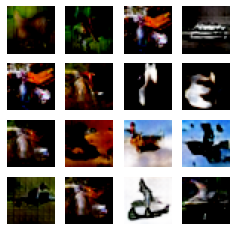

Time for training : 19596 sec


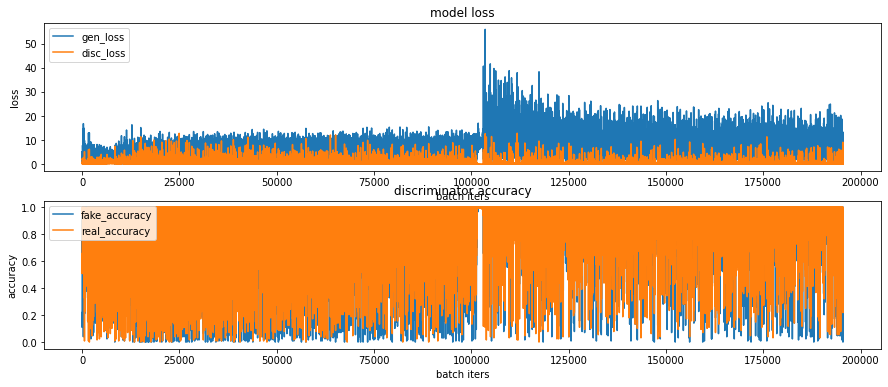

CPU times: user 5h 39min 46s, sys: 21min 59s, total: 6h 1min 46s
Wall time: 5h 26min 47s


In [38]:
%%time
train(train_dataset, EPOCHS, save_every)

# 학습과정의 loss, accuracy 그래프 이미지 파일이 ~/aiffel/dcgan_newimage/cifar10/training_history 경로에 생성되고 있으니
# 진행 과정을 수시로 확인해 보시길 권합니다.

In [39]:
# 학습과정 시각화
anim_file = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/cifar10_dcgan5_1(500epochs).gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('{}/aiffel/dcgan_newimage/cifar10/generated_samples5/sample*.png'.format(os.getenv('HOME')))
    filenames = sorted(filenames)
    last = -1
    for i, filename in enumerate(filenames):
        frame = 2*(i**0.5)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

!ls -l ~/aiffel/dcgan_newimage/cifar10/cifar10_dcgan4_1(500epochs).gif

/bin/bash: -c: line 0: syntax error near unexpected token `('
/bin/bash: -c: line 0: `ls -l ~/aiffel/dcgan_newimage/cifar10/cifar10_dcgan4_1(500epochs).gif'


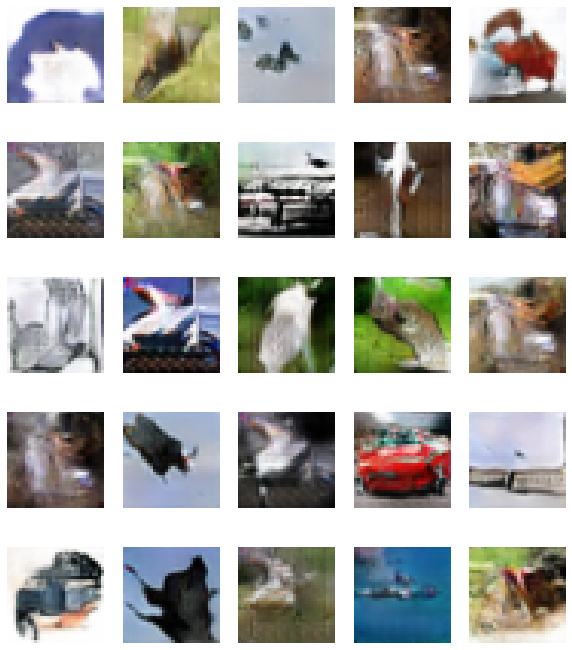

In [45]:
checkpoint_dir = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/training_checkpoints5'

latest = tf.train.latest_checkpoint(checkpoint_dir)
checkpoint.restore(latest)

generator = checkpoint.generator
discriminator = checkpoint.discriminator

plt.figure(figsize=(10, 12))

for i in range(25):
    plt.subplot(5,5,i+1)
    noise = tf.random.normal([1, 100])
    generated_image = generator(noise, training=False)
    
    np_generated = generated_image.numpy()
    np_generated = (np_generated * 127.5) + 127.5   # reverse of normalization
    np_generated = np_generated.astype(int)
    plt.imshow(np_generated[0])
    plt.axis('off')

plt.show()

## STEP 8. (optional) GAN 훈련 과정 개선하기


## 시도 1

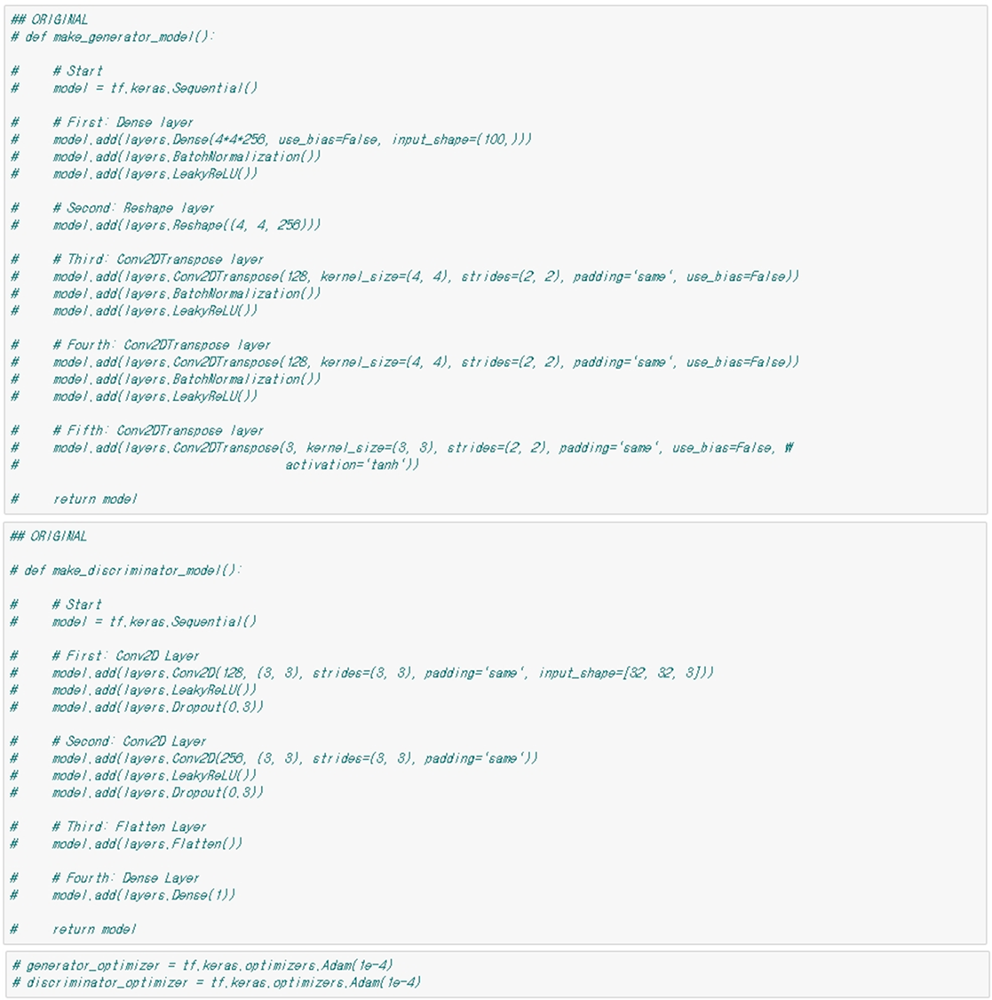

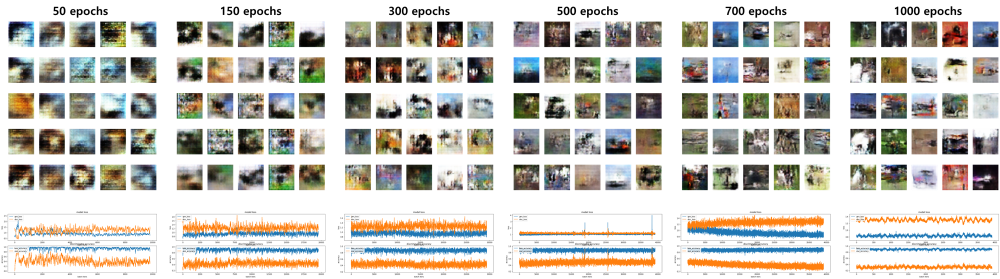

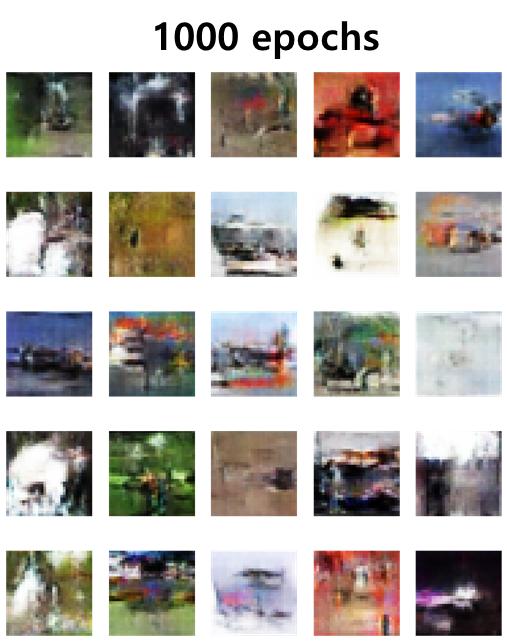

- 1000epoch을 돌려서 나온 결과를 확인해보면 아직 각각의 사진이 어떤 사진인지는 확인 불가한 것을 볼 수 있습니다.

## 시도 2

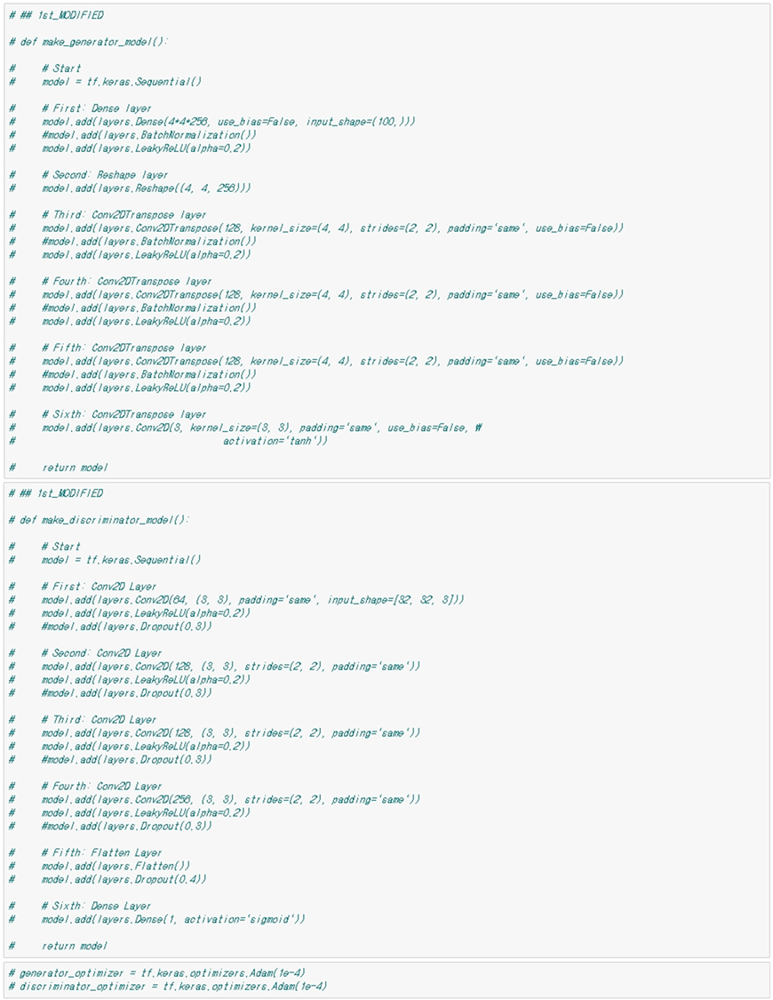

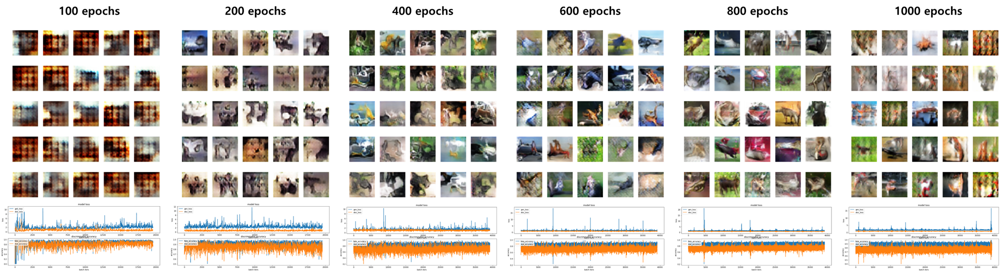

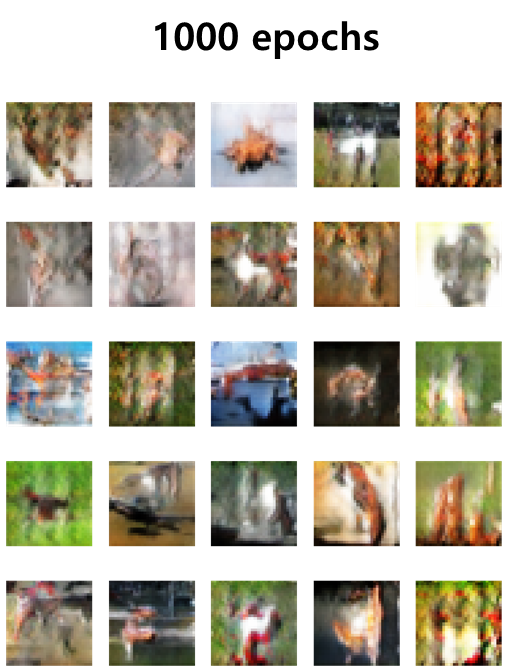

- generator와 discriminator 함수에 레이어를 더 추가하여 1000epochs을 돌려서 결과를 확인해봤습니다. (Conv2DTranspose, LeakyRelu, BatchNormalization, Conv2D, Dropout)
- 그래프를 확인해보면 1000epochs 구간에서 loss가 갑자기 튀어 오르는 것을 확인할 수 있습니다. 그래서 그런지 몰라도 사진들을 더 확인하기 힘든 것을 볼 수 있습니다. 

## 시도 3

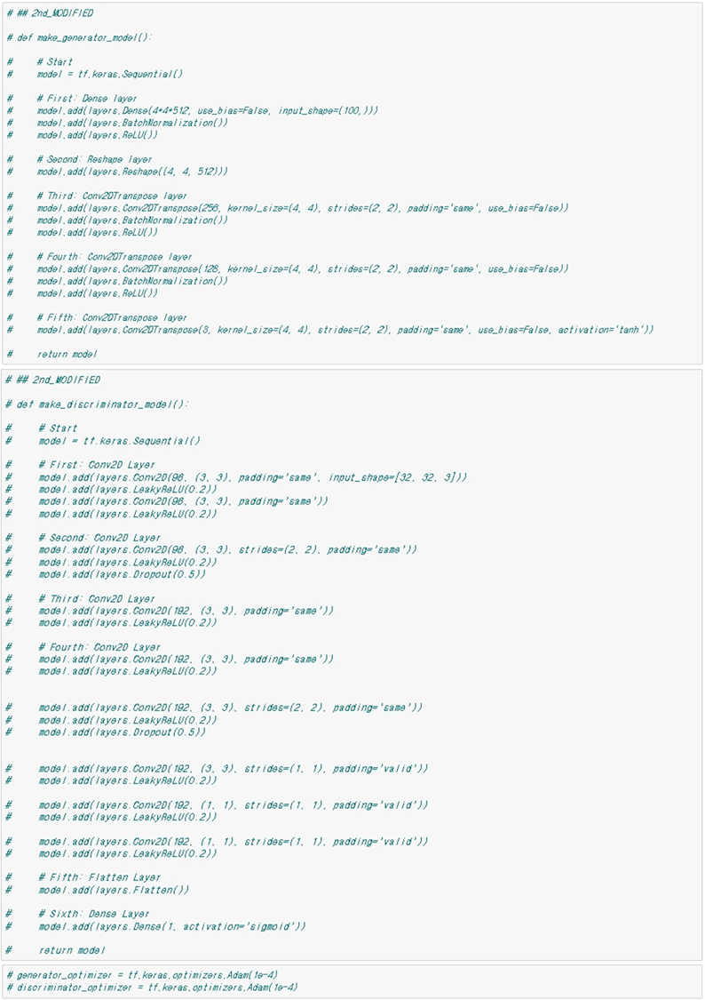

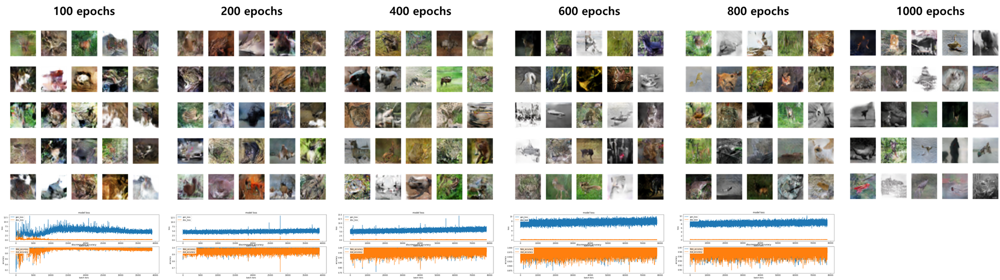

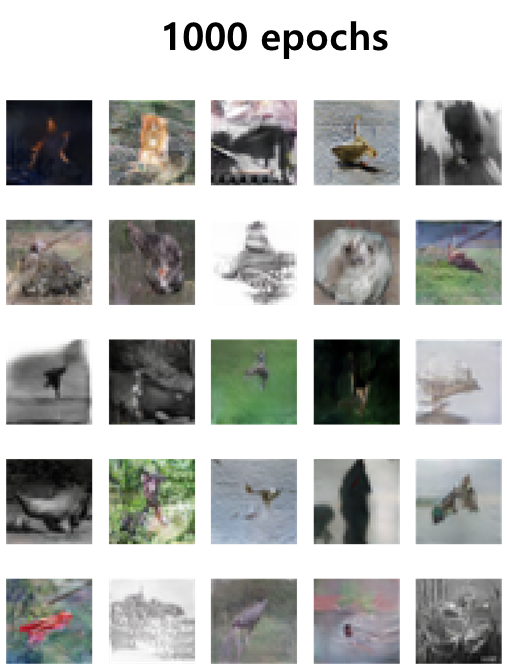

- generator와 discriminator에 최대한 많은 여러가지 레이어를 추가해서 나온 결과입니다. 
- 사진안에 있는 물체는 정확하게 확인은 불가하지만, 새들이 많이 포함되어 있는 것으로 보입니다. 

## 시도 4

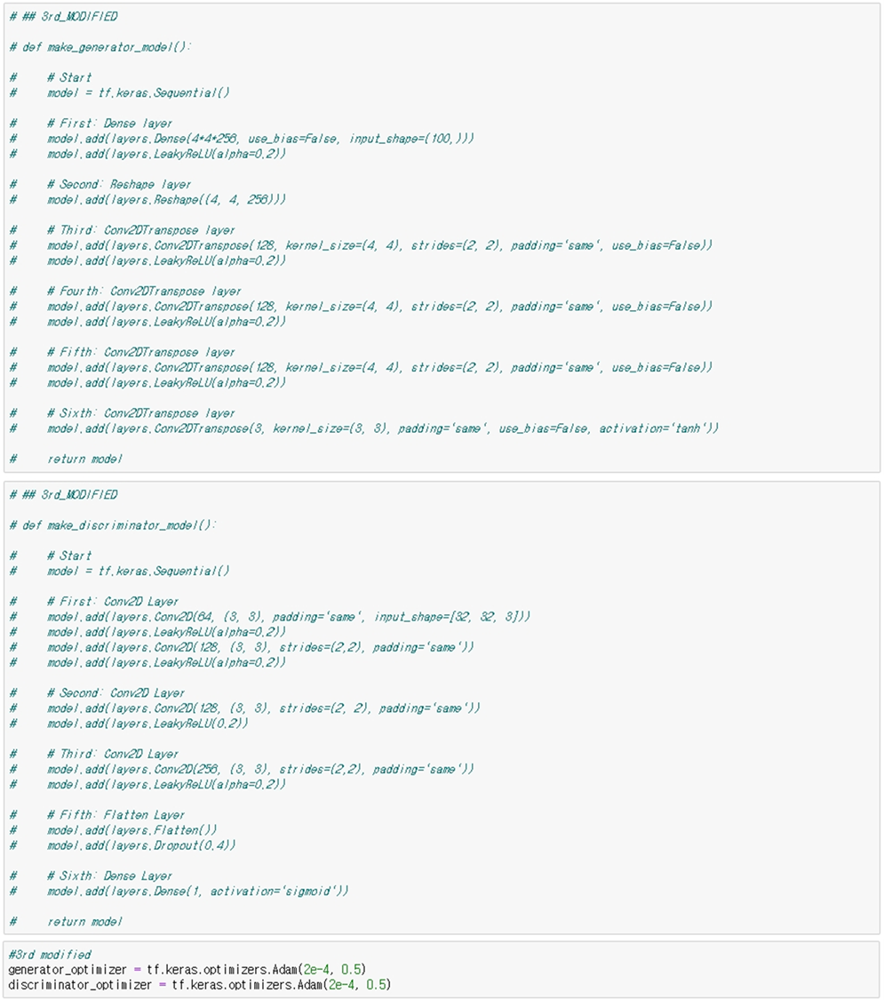

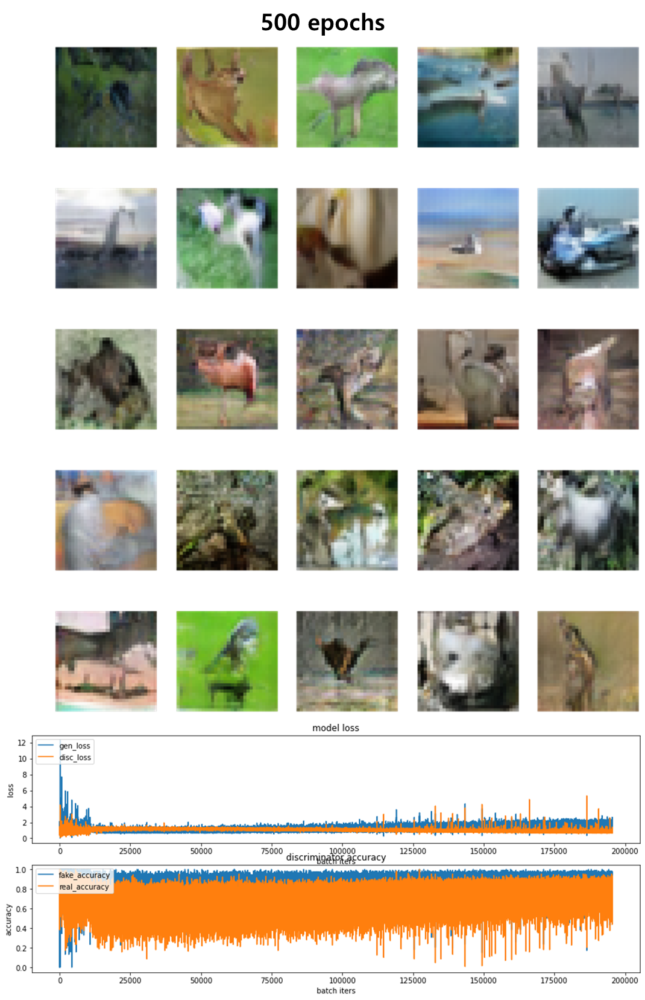

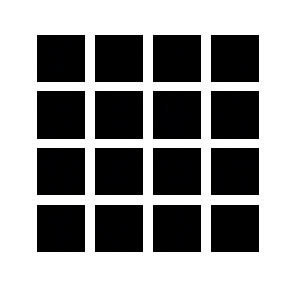

- 이번에는 다른 사람이 dcGAN 논문을 보고 만든 레이어를 따라서 만들어 보았습니다. 
- [How to Develop a GAN to Generate CIFAR10 Small Color Photographs](https://machinelearningmastery.com/how-to-develop-a-generative-adversarial-network-for-a-cifar-10-small-object-photographs-from-scratch/)
- 어렴풋이 보면 샘플 사진에 새들도 보이고, 사슴도 보이고, 차도 보이는 것을 확인할 수 있습니다. 

## 시도 5

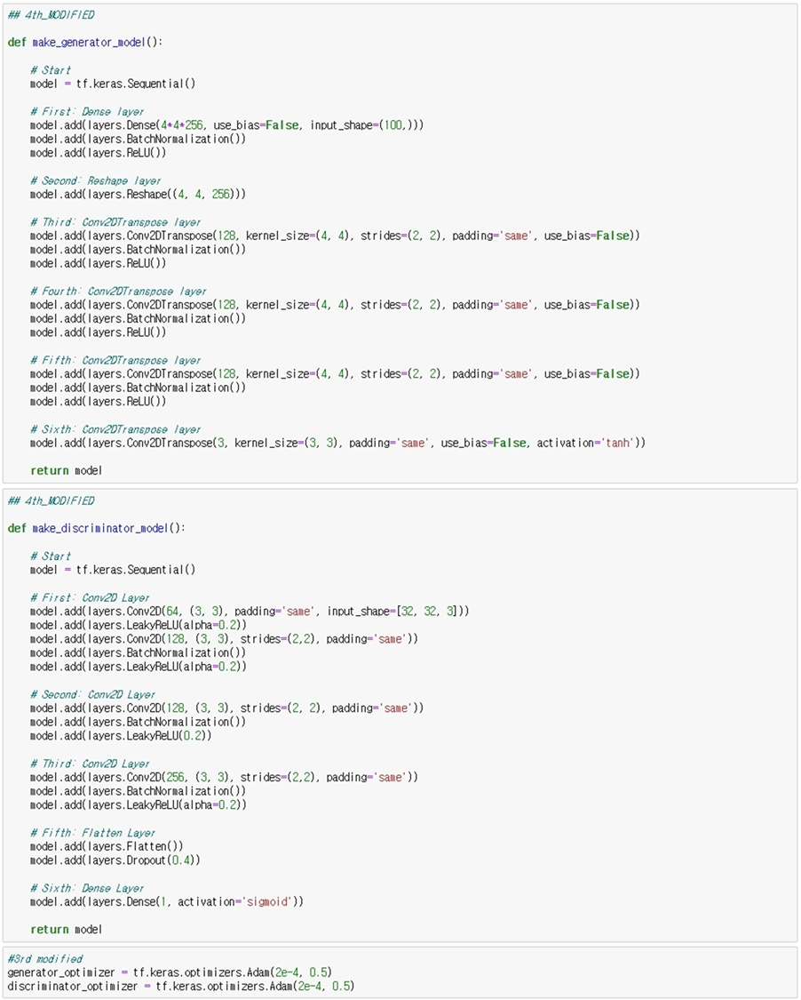

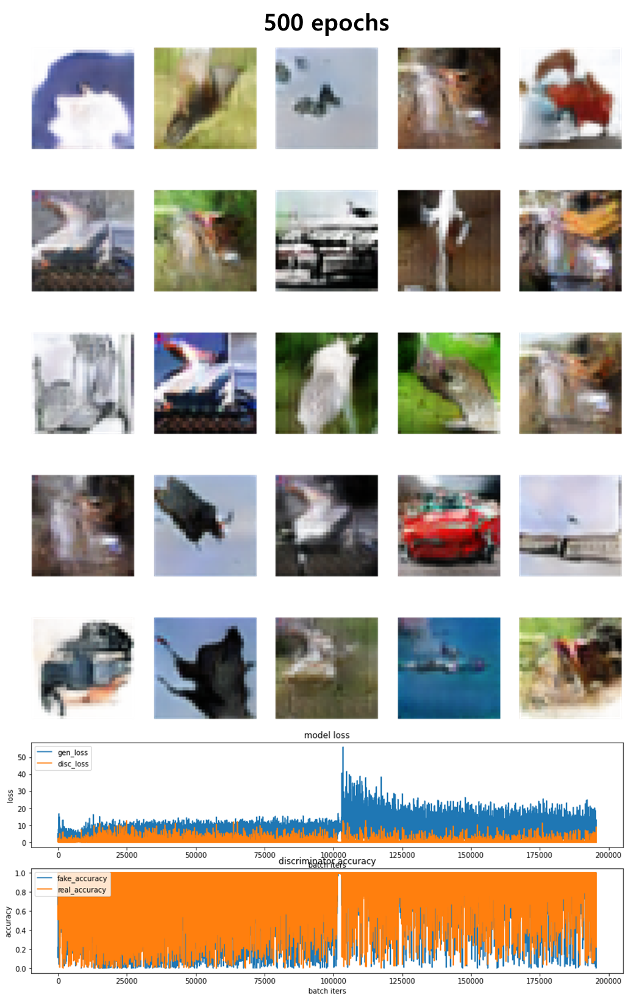

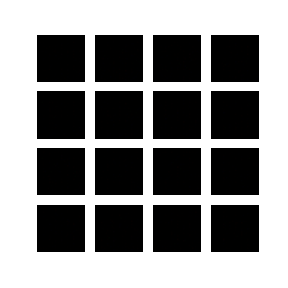

- generator의 함수에서 LeakyRelu를 Relu로 변경하고 학습속도를 조금 더 빠르게 변경하여서 적용했습니다. 
- 마지막 시도에서 그나마 제일 물체들을 확인할 수 있는 것을 확인할 수 있습니다. 